In [18]:
from numba import jit
import numpy as np
import matplotlib.pyplot as plt
# @jit(nopython=True)
def make_Bijk(N):
    Bijk = np.ones((N,N,N)) - np.eye(N)
    for i in range(N): Bijk[i,i,:]=0;Bijk[i,:,i]=0
    return Bijk

In [19]:
N = 50
Nt = N *2
Aij = np.ones((Nt,Nt)) - np.eye(Nt)
nu = 0.7 # inter group interaction
mu = 1 - nu # group-by group interaction
Bijk = make_Bijk(Nt) * mu
Bijk[:N-1,:N-1,:N-1] *= nu
Bijk[N-1:,N-1:,N-1:] *= nu



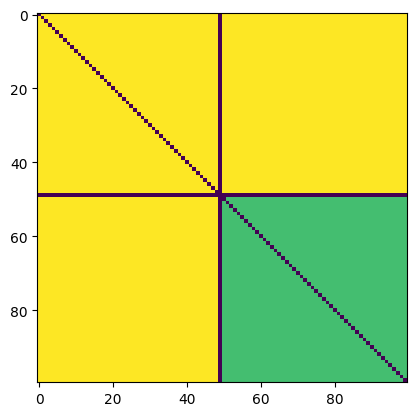

In [20]:
plt.imshow(Bijk[2])
plt.imshow(Bijk[49])

In [21]:
def Kuramoto_SOL_CHIMERA(Theta,t,omega,Bijk,beta):
    # print("Case m = 0")
    theta = Theta.copy()
    # theta_i,theta_j = np.meshgrid(theta,theta,sparse=False,indexing='ij')
    i,j,k = np.meshgrid(theta,theta,theta,sparse=False,indexing='ij')
    # theta_i,theta_j = np.meshgrid(theta,theta,sparse=True)
    dtheta = omega + np.sum(np.sum(Bijk*np.sin(j+k-2*i-beta),axis=2),axis=1)
    return dtheta

def get_order_parameter(theta):
    ''' get theta and return r and theta'''
    rpsi = np.mean(np.exp(1j*theta))
    r = np.abs(rpsi)
    psi = np.angle(rpsi)
    return r,psi


def Kuramoto_MF_CHIMERA(Theta,t,N1,omega,K111,K112,K122,beta):
    # print("Case m = 0")
    theta = Theta.copy()
    theta1,theta2 = theta[:N1],theta[N1:] 
    r1,psi1 = get_order_parameter(theta1)
    r2,psi2 = get_order_parameter(theta2)
    dtheta1  = omega + K111*r1*r1*np.sin(2*(psi1-theta1)-beta) + 2*K112*r1*r2*np.sin(psi1+psi2-2*theta1-beta) + K122*r2*r2*np.sin(2*(psi2-theta1)-beta)
    dtheta2  = omega + K111*r2*r2*np.sin(2*(psi2-theta2)-beta) + 2*K112*r1*r2*np.sin(psi1+psi2-2*theta2-beta) + K122*r1*r1*np.sin(2*(psi1-theta2)-beta)
    theta[:N1] = dtheta1
    theta[N1:] = dtheta2
    return theta

In [22]:
# i,j,k = np.meshgrid([0,1,2],[0,1,2],[0,1,2],sparse=False,indexing='ij')
i,j = np.meshgrid([0,1,2],[0,1,2],sparse=False,indexing='ij')

In [23]:
t = np.arange(0,3,0.01)
Theta = np.random.uniform(0,2*np.pi,Nt)

In [24]:
def RK4(f, y0, t, args=()):
    n = len(t)
    y = np.zeros((n, len(y0)))
    y[0] = y0

    for i in range(n - 1):
        h = t[i + 1] - t[i]
        k1 = f(y[i], t[i], *args)
        k2 = f(y[i] + k1 * h / 2.0, t[i] + h / 2.0, *args)
        k3 = f(y[i] + k2 * h / 2.0, t[i] + h / 2.0, *args)
        k4 = f(y[i] + k3 * h, t[i] + h, *args)
        y[i + 1] = y[i] + (h / 6.0) * (k1 + 2 * k2 + 2 * k3 + k4)
    return y

In [25]:
N = 20
Nt = N *2
Aij = np.ones((Nt,Nt)) - np.eye(Nt)
nu = 0.7 # inter group interaction
mu = 1 - nu # inter group 2, outer group 1
xi = 0.1 # inter group 1, outer group 2


def make_BIJK2(nu,mu,xi,SS,Nt):
    Bijk = make_Bijk(Nt) * mu
    B0 = np.where(Bijk==0)
    Bijk[:SS,:SS,:SS] = nu #G111
    Bijk[SS:,SS:,SS:] = nu #G222

    Bijk[:SS,:SS,SS:] = 2*mu #G112
    Bijk[:SS,SS:,:SS] = 0*mu #G121
    Bijk[SS:,SS:,:SS] = 2*mu #G221
    Bijk[SS:,:SS,SS:] = 0*mu #G212

    Bijk[:SS,SS:,SS:] = xi #G122
    Bijk[SS:,:SS,:SS] = xi #G211
    Bijk[B0] = 0
    return Bijk


def make_BIJK(nu,mu,xi,SS,Nt):
    Bijk = make_Bijk(Nt) * mu
    B0 = np.where(Bijk==0)
    SS1,SS2 = SS, Nt - SS
    Bijk[:SS,:SS,:SS] = nu/(SS1*SS1) #G111
    Bijk[SS:,SS:,SS:] = nu/(SS2*SS2) #G222

    Bijk[:SS,:SS,SS:] = mu/(SS1*SS2) #G112
    Bijk[:SS,SS:,:SS] = mu/(SS1*SS2) #G121
    Bijk[SS:,SS:,:SS] = mu/(SS2*SS1) #G221
    Bijk[SS:,:SS,SS:] = mu/(SS2*SS1) #G212

    Bijk[:SS,SS:,SS:] = xi/(SS2*SS2) #G122
    Bijk[SS:,:SS,:SS] = xi/(SS1*SS1) #G211
    Bijk[B0] = 0
    return Bijk



In [26]:
a = [1,1,2,2]
A,B,C = np.meshgrid(a,a,a,indexing='ij')

In [27]:
C[2:,:2,:2]
# B[:2,:2,:2]

array([[[1, 1],
        [1, 1]],

       [[1, 1],
        [1, 1]]])

In [28]:
t = np.arange(0,300,0.1)
omega =  0
beta = 0.2

nu = 0.7
mu = (1-nu)/2
xi = 0.1
SS = N 
Bijk = make_BIJK(nu=nu,mu=mu,xi=xi,SS =SS,Nt = 2*N)
# Bijk2 = make_BIJK2(nu=nu,mu=mu,xi=xi,SS =SS,Nt = 2*N)
K111,K112,K122 = nu,mu,xi
Theta = np.random.uniform(0,2*np.pi,Nt)


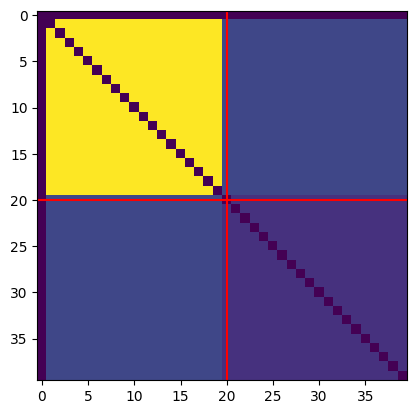

In [29]:
plt.imshow(Bijk[0])
plt.axhline(N,color='red')
plt.axvline(N,color='red')

In [30]:
sol = RK4(Kuramoto_SOL_CHIMERA,Theta,t,args=(omega,Bijk,beta))
rabs2_1 = np.mean(np.exp(2*sol[:,:SS].T*1j),axis=0)
rabs2_2 = np.mean(np.exp(2*sol[:,SS:].T*1j),axis=0)
rabs1_1 = np.mean(np.exp(sol[:,:SS].T*1j),axis=0)
rabs1_2 = np.mean(np.exp(sol[:,SS:].T*1j),axis=0)

# rabs2_ = rabs2__[len(t)//2:]
r2_1 = np.abs(rabs2_1)
r2_2 = np.abs(rabs2_2)

r1_1 = np.abs(rabs1_1)
r1_2 = np.abs(rabs1_2)



In [31]:
# Kuramoto_MF_CHIMERA(Theta,t,N1,omega,K111,K112,K122,beta):
t1 = np.arange(0,300,0.1)

# t1 = t*10
N1 = SS
sol_MF = RK4(Kuramoto_MF_CHIMERA,Theta,t1,args=(N1,omega,K111,K112,K122,beta))
# sol_MF = RK4(Kuramoto_MF_HO,Theta,t1,args=(N1,omega,K2,beta))

In [32]:
t1 = t1[::10]
rabs2_1_MF = np.mean(np.exp(2*sol_MF[::10,:SS].T*1j),axis=0)
rabs2_2_MF = np.mean(np.exp(2*sol_MF[::10,SS:].T*1j),axis=0)
rabs1_1_MF = np.mean(np.exp(sol_MF[::10,:SS].T*1j),axis=0)
rabs1_2_MF = np.mean(np.exp(sol_MF[::10,SS:].T*1j),axis=0)

# rabs2_ = rabs2__[len(t)//2:]
r2_1_MF = np.abs(rabs2_1_MF)
r2_2_MF = np.abs(rabs2_2_MF)
r1_1_MF = np.abs(rabs1_1_MF)
r1_2_MF = np.abs(rabs1_2_MF)



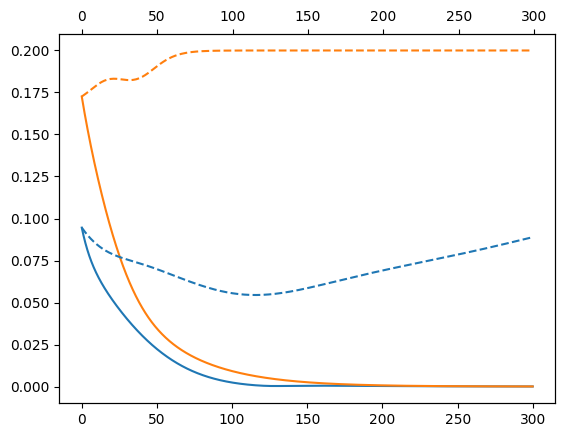

In [33]:
plt.plot(t,r1_1)
plt.plot(t,r1_2)

plt.twiny()

plt.plot(t1,r1_1_MF,ls='--')
plt.plot(t1,r1_2_MF,ls='--')

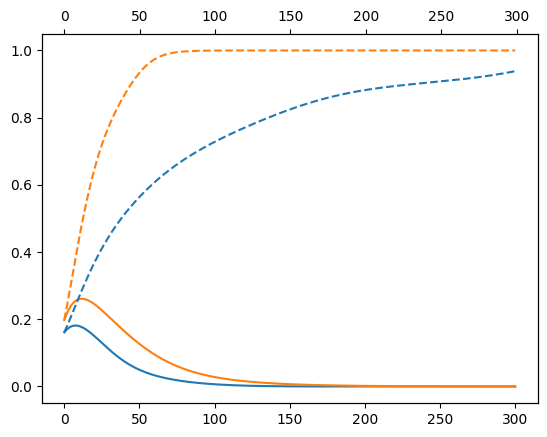

In [34]:
plt.plot(t,r2_1)
plt.plot(t,r2_2)

plt.twiny()

plt.plot(t1,r2_1_MF,ls='--')
plt.plot(t1,r2_2_MF,ls='--')

In [ ]:
# sol = RK4(Kuramoto_SOL_CHIMERA,Theta,t,args=(1,N,1,2,0))
r1_1s = []
r2_1s = []

r1_2s = []
r2_2s = []


for i in range(100):
    Theta = np.random.uniform(0,2*np.pi,Nt)
    sol = RK4(Kuramoto_SOL_CHIMERA,Theta,t,args=(omega,Bijk,beta))


    rabs2_1 = np.mean(np.exp(2*sol[:,:SS].T*1j),axis=0)
    rabs2_2 = np.mean(np.exp(2*sol[:,SS:].T*1j),axis=0)

    rabs1_1 = np.mean(np.exp(sol[:,:SS].T*1j),axis=0)
    rabs1_2 = np.mean(np.exp(sol[:,SS:].T*1j),axis=0)

    # rabs2_ = rabs2__[len(t)//2:]
    r2_1 = np.abs(rabs2_1)
    r2_2 = np.abs(rabs2_2)

    r1_1 = np.abs(rabs1_1)
    r1_2 = np.abs(rabs1_2)
    R11_std,R12_std = np.std(r1_1[-50:]),np.std(r1_2[-50:])
    R21_std,R22_std = np.std(r2_1[-50:]),np.std(r2_2[-50:])
    R11,R12 = r1_1[-1],r1_2[-1]
    R21,R22 = r2_1[-1],r2_2[-1]
    print('r1',r1_1[-1],r1_2[-1])
    print('r1std',R11_std,R12_std)
    print('r2',r2_1[-1],r2_2[-1])
    print('r2std',R21_std,R22_std)

    r1_1s.append(R11)
    r2_1s.append(R21)
    r1_2s.append(R12)
    r2_2s.append(R22)
    if (abs(R21-R22)>0.2 and (R22+R21)>0.7) and (R21_std or R22_std)>1e-3: break

r1 0.30870334047631376 0.06593716908291677
r1std 5.037495906625191e-05 0.001692593491998445
r2 0.9894101061452661 0.07969760364552593
r2std 6.215000808153072e-05 0.006846509244114269
r1 3.984154086724118e-15 5.14382035059337e-15
r1std 1.0414122776939698e-13 5.2359278040202896e-14
r2 8.1601392309949e-15 8.920999519292767e-15
r2std 3.4487992760786954e-13 4.725634583018905e-13
r1 8.661340727264551e-14 8.496418955152031e-14
r1std 3.124475755933677e-12 2.782347950955868e-12
r2 5.428748397751588e-14 5.3683502381553925e-14
r2std 4.030473127309601e-12 2.852343313336502e-12
r1 1.823802210144002e-14 2.1002767862177025e-14
r1std 7.21430837918361e-13 8.707554413719545e-13
r2 3.4228384825623095e-14 3.717264110070726e-14
r2std 9.32377217750991e-13 1.7483045501690616e-12
r1 1.229638666795003e-13 1.8571346697083765e-14
r1std 1.8941250709182737e-12 3.2384611909540536e-12
r2 6.886684502732944e-13 3.215822627449615e-13
r2std 3.199498963976276e-12 1.1649569677829083e-11
r1 7.014440468607525e-14 9.30101575

In [15]:
# Theta = np.random.uniform(0,2*np.pi,Nt)

t = np.arange(0,30,0.01)
omega= 0
sol = RK4(Kuramoto_SOL_CHIMERA,Theta,t,args=(omega,Bijk,beta))

rabs2_1 = np.mean(np.exp(2*sol[:,:SS].T*1j),axis=0)
rabs2_2 = np.mean(np.exp(2*sol[:,SS:].T*1j),axis=0)

rabs1_1 = np.mean(np.exp(sol[:,:SS].T*1j),axis=0)
rabs1_2 = np.mean(np.exp(sol[:,SS:].T*1j),axis=0)

# rabs2_ = rabs2__[len(t)//2:]
r2_1 = np.abs(rabs2_1)
r2_2 = np.abs(rabs2_2)

r1_1 = np.abs(rabs1_1)
r1_2 = np.abs(rabs1_2)

In [16]:
# Theta = np.random.uniform(0,2*np.pi,Nt)

# t = np.arange(0,10,0.01)
omega = 0
sol = RK4(Kuramoto_SOL_CHIMERA,Theta,t,args=(omega,Bijk2,beta))

rabs2_11 = np.mean(np.exp(2*sol[:,:SS].T*1j),axis =0)
rabs2_21 = np.mean(np.exp(2*sol[:,SS:].T*1j),axis=0)
rabs1_11 = np.mean(np.exp(sol[:,:SS].T*1j),axis=0)
rabs1_21 = np.mean(np.exp(sol[:,SS:].T*1j),axis=0)

# rabs2_ = rabs2__[len(t)//2:]
r2_11 = np.abs(rabs2_11)
r2_21 = np.abs(rabs2_21)
r1_11 = np.abs(rabs1_11)
r1_21 = np.abs(rabs1_21)

In [14]:
r1_12.shape

NameError: name 'r1_12' is not defined

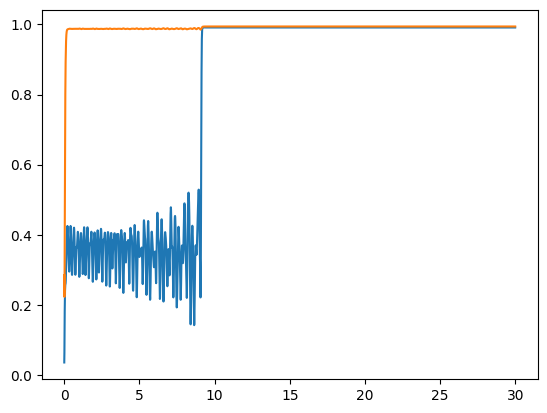

In [17]:
plt.plot(t,r2_1)
plt.plot(t,r2_2)

In [22]:
r2 = rabs1_1*rabs1_1

In [24]:
abs(r2)

array([0.00088736, 0.00115438, 0.00156013, ..., 0.16443595, 0.16443595,
       0.16443595])

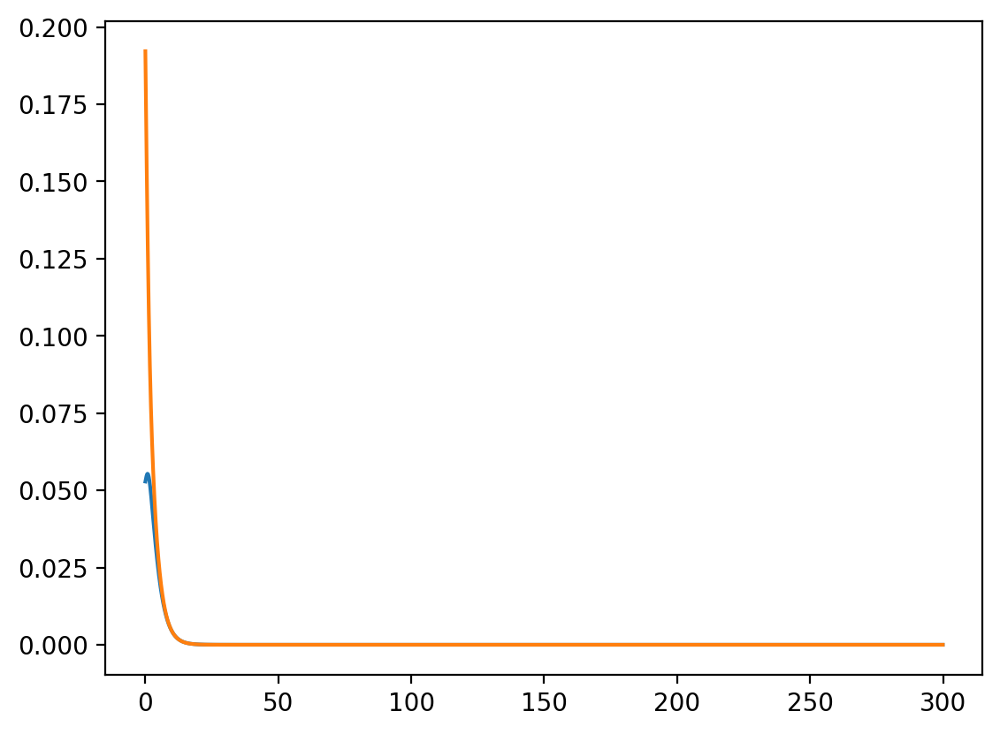

In [491]:
plt.plot(t,r1_1)
plt.plot(t,r1_2)
# plt.xlim(0,3)

(array([23.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0., 77.]),
 array([3.21252460e-06, 9.99502794e-02, 1.99897346e-01, 2.99844413e-01,
        3.99791480e-01, 4.99738547e-01, 5.99685614e-01, 6.99632680e-01,
        7.99579747e-01, 8.99526814e-01, 9.99473881e-01]),
 <BarContainer object of 10 artists>)

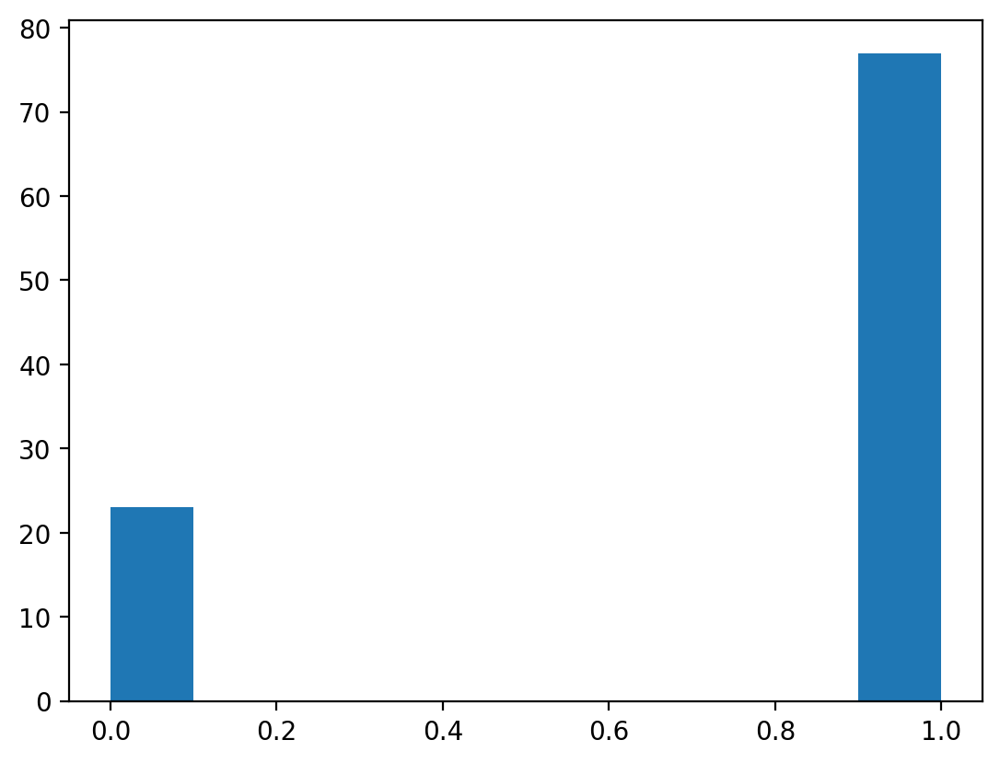

In [ ]:
# plt.hist(r2_2s)
plt.hist(r2_1s)

(array([1., 0., 0., 0., 0., 0., 0., 0., 0., 3.]),
 array([0.20626821, 0.28563986, 0.3650115 , 0.44438315, 0.52375479,
        0.60312644, 0.68249808, 0.76186972, 0.84124137, 0.92061301,
        0.99998466]),
 <BarContainer object of 10 artists>)

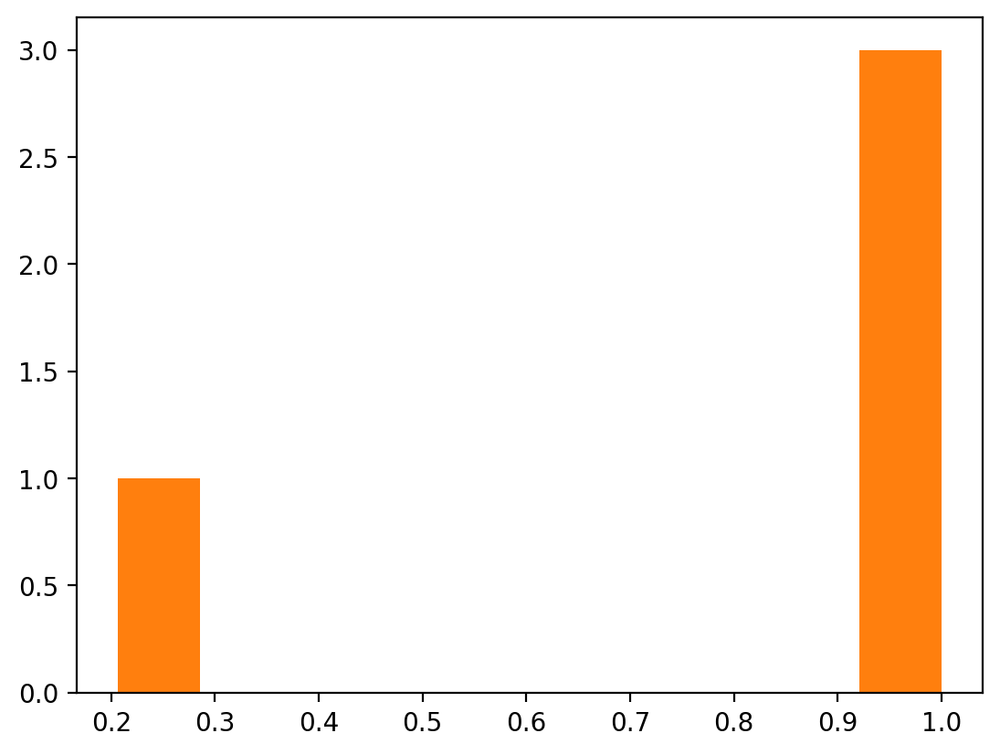

In [ ]:
plt.hist(r2_1s)
plt.hist(r2_2s)

In [501]:
sol =  sol_MF

(-1.0999986402114572,
 1.0999986402114572,
 -1.0999997527658723,
 1.0999948080833182)

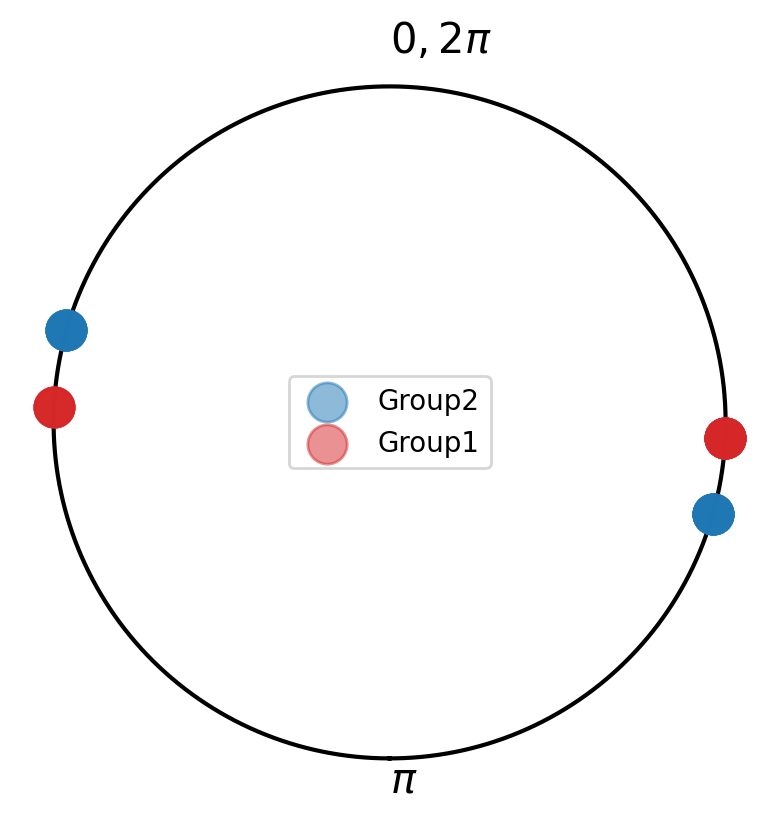

In [502]:
x = np.linspace(-np.pi,np.pi,1000)
fig = plt.figure()
ax =plt.gca()
ax.set_aspect(1)
ax.plot(np.sin(x),np.cos(x),color='k',zorder=-10)
idx= -2;
sca2 = ax.scatter(np.sin(sol[idx][:SS]),np.cos(sol[idx][:SS]),color='tab:blue',label='Group2',s=200,alpha=0.5)
sca1 = ax.scatter(np.sin(sol[idx][SS:]),np.cos(sol[idx][SS:]),color='tab:red',label='Group1',s=200,alpha=0.5)
ax.legend()
# idx= -1;plt.scatter(np.sin(sol[idx]),np.cos(sol[idx]))
# idx= 110;plt.scatter(np.sin(sol[-idx]),np.cos(sol[-idx]))
plt.text(0,1.1,r'$0,2\pi$',fontsize=15)
plt.text(0,-1.1,r'$\pi$',fontsize=15)
plt.axis('off')

In [503]:
A= sca1.get_offsets()

In [504]:
# mask = [[for]]
def FOR_DATA(sol):
    DATA1 = list(zip(np.cos(sol[:,:SS]),np.sin(sol[:,:SS])))
    DATA2 = list(zip(np.cos(sol[:,SS:]),np.sin(sol[:,SS:])))
    DATA1 = [list(zip(*data)) for data in DATA1] 
    DATA2 = [list(zip(*data)) for data in DATA2]
    return DATA1,DATA2 

DATA1,DATA2 = FOR_DATA(sol)

def get_ani(idx):
    sca1.set_offsets(DATA1[idx])
    sca2.set_offsets(DATA2[idx])


In [505]:
len(t)

3000

In [506]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

In [507]:
%config InlineBackend.figure_format = 'retina'
idxs=  np.arange(0,300,1)
ani = FuncAnimation(fig,get_ani,frames=idxs,interval=50)

In [508]:
len(t)

3000

In [509]:
HTML(ani.to_jshtml())
# ani.save(rf'HIGH ORDER CHIMERA/SB_B 2pi N={N},mu={mu:.01f},nu={nu:.01f},xi={xi:.01f},beta={beta:.01f}.mp4',dpi=300)

(-1.0999986402114572,
 1.0999986402114572,
 -1.0999997527658723,
 1.0999948080833182)

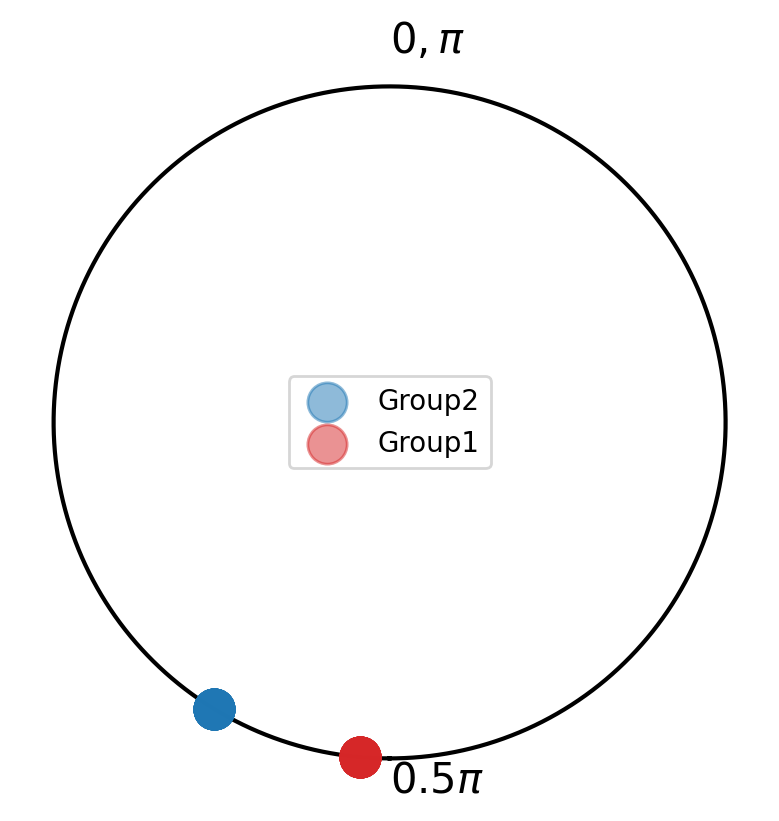

In [510]:
x = np.linspace(-np.pi,np.pi,1000)
fig = plt.figure()
plt.axes().set_aspect(1)
plt.plot(np.sin(x),np.cos(x),color='k',zorder=-10)
ax = plt.gca()
idx= -1;
sca2 = ax.scatter(np.sin(2*sol[idx][:SS]),np.cos(2*sol[idx][:SS]),color='tab:blue',label='Group2',s=200,alpha=0.5)
sca1 = ax.scatter(np.sin(2*sol[idx][SS:]),np.cos(2*sol[idx][SS:]),color='tab:red',label='Group1',s=200,alpha=0.5)
plt.legend()
# idx= -1;plt.scatter(np.sin(sol[idx]),np.cos(sol[idx]))
# idx= 110;plt.scatter(np.sin(sol[-idx]),np.cos(sol[-idx]))

plt.text(0,1.1,r'$0,\pi$',fontsize=15)
plt.text(0,-1.1,r'$0.5\pi$',fontsize=15)
plt.axis('off')

In [511]:
# mask = [[for]]
def FOR_DATA(sol):
    DATA1 = list(zip(np.cos(2*sol[:,:SS]),np.sin(2*sol[:,:SS])))
    DATA2 = list(zip(np.cos(2*sol[:,SS:]),np.sin(2*sol[:,SS:])))
    DATA1 = [list(zip(*data)) for data in DATA1] 
    DATA2 = [list(zip(*data)) for data in DATA2]
    return DATA1,DATA2 

DATA1,DATA2 = FOR_DATA(sol)

def get_ani(idx):
    sca1.set_offsets(DATA1[idx])
    sca2.set_offsets(DATA2[idx])


In [512]:
len(t)

3000

In [514]:
%config InlineBackend.figure_format = 'retina'
idxs=  np.arange(0,300,1)
ani = FuncAnimation(fig,get_ani,frames=idxs,interval=50)
HTML(ani.to_jshtml())

# ani.save(rf'HIGH ORDER CHIMERA/SB_B pi N={N},mu={mu:.01f},nu={nu:.01f},xi={xi:.01f},beta={beta:.01f}.mp4',dpi=300)

In [310]:
rabs2_1 = np.mean(np.exp(2*sol[:,:SS].T*1j),axis=0)
rabs2_2 = np.mean(np.exp(2*sol[:,SS:].T*1j),axis=0)

rabs1_1 = np.mean(np.exp(sol[:,:SS].T*1j),axis=0)
rabs1_2 = np.mean(np.exp(sol[:,SS:].T*1j),axis=0)

# rabs2_ = rabs2__[len(t)//2:]
r2_1 = np.abs(rabs2_1)
r2_2 = np.abs(rabs2_2)

r1_1 = np.abs(rabs1_1)
r1_2 = np.abs(rabs1_2)

print(r2_1[-1],r2_2[-1])

0.1100436866667463 0.999226689992902


In [515]:
dt = t1[1]- t1[0]
V_theta =  np.diff(sol,axis=1)/dt

In [516]:
np.diff(sol[:,0])/dt

array([-0.00103373, -0.00104125, -0.00104881, ..., -0.00212497,
       -0.00212497, -0.00212497])

In [517]:
V_theta, sol

(array([[-2.71469081e+00,  2.33252190e+00, -8.40034461e-01, ...,
          1.20105724e+00, -1.41839714e+00, -3.68970389e+00],
        [-2.71424565e+00,  2.33228120e+00, -8.38490965e-01, ...,
          1.19719661e+00, -1.41273265e+00, -3.68758304e+00],
        [-2.71380087e+00,  2.33204614e+00, -8.36938921e-01, ...,
          1.19329296e+00, -1.40702209e+00, -3.68542004e+00],
        ...,
        [-3.14159265e+00,  3.14159265e+00, -5.96720451e-11, ...,
          0.00000000e+00,  0.00000000e+00, -3.14159265e+00],
        [-3.14159265e+00,  3.14159265e+00, -5.91813265e-11, ...,
          0.00000000e+00,  0.00000000e+00, -3.14159265e+00],
        [-3.14159265e+00,  3.14159265e+00, -5.86948268e-11, ...,
          0.00000000e+00,  0.00000000e+00, -3.14159265e+00]]),
 array([[ 5.18852001,  2.4738292 ,  4.8063511 , ...,  5.94781812,
          4.52942097,  0.83971708],
        [ 5.18748628,  2.47324064,  4.80552184, ...,  5.9444617 ,
          4.53172906,  0.84414602],
        [ 5.18644503,  2.

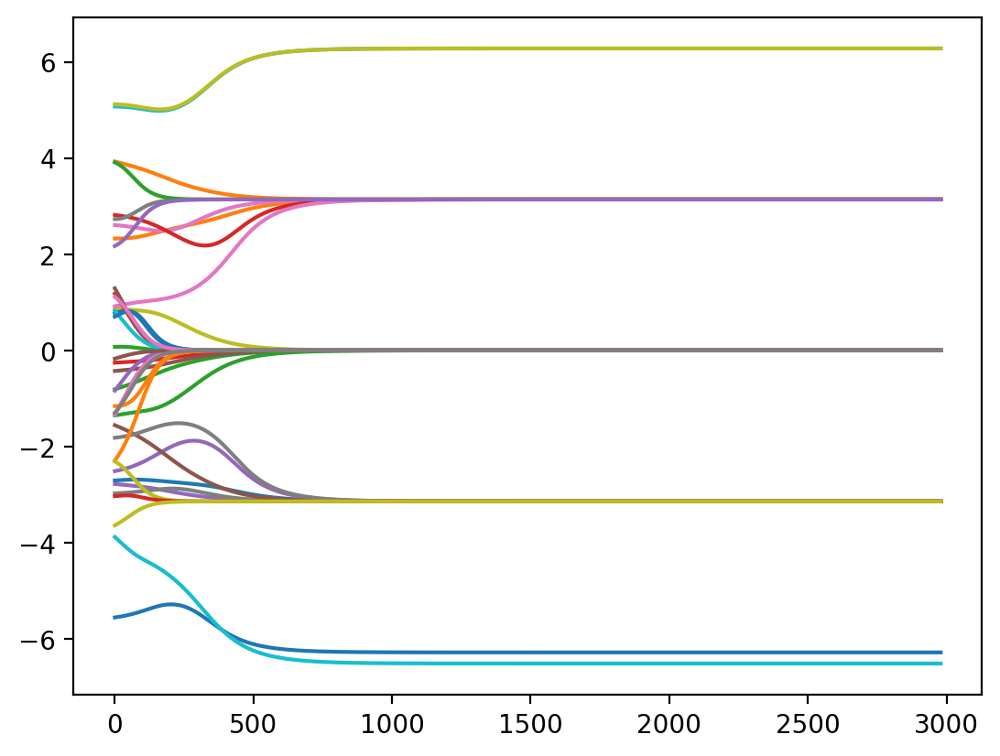

In [518]:
plt.plot(V_theta[N:])
# plt.plot(V_theta[-1][49])

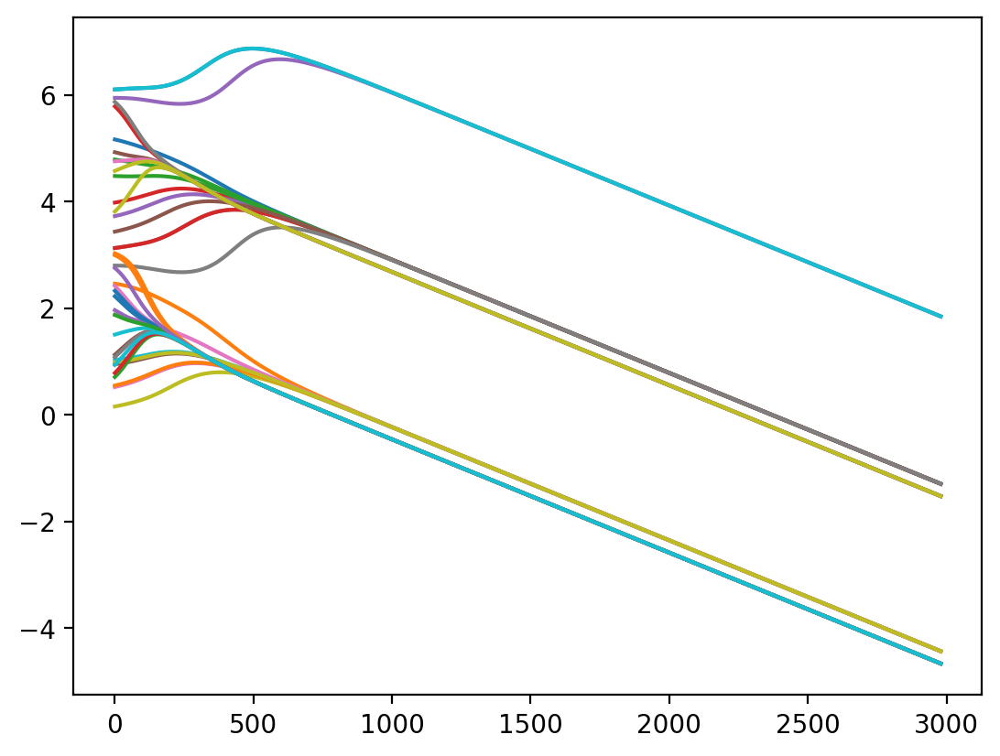

In [519]:
# plt.plot((sol.T-t).T[:N])
# plt.plot((sol.T-t).T[N:])
# plt.plot((sol.T).T[:N])
plt.plot((sol.T).T[N:])

# plt.plot(t)
# plt.plot((sol))

Text(0, 0.5, '$r_{2,1},r_{2,2}$')

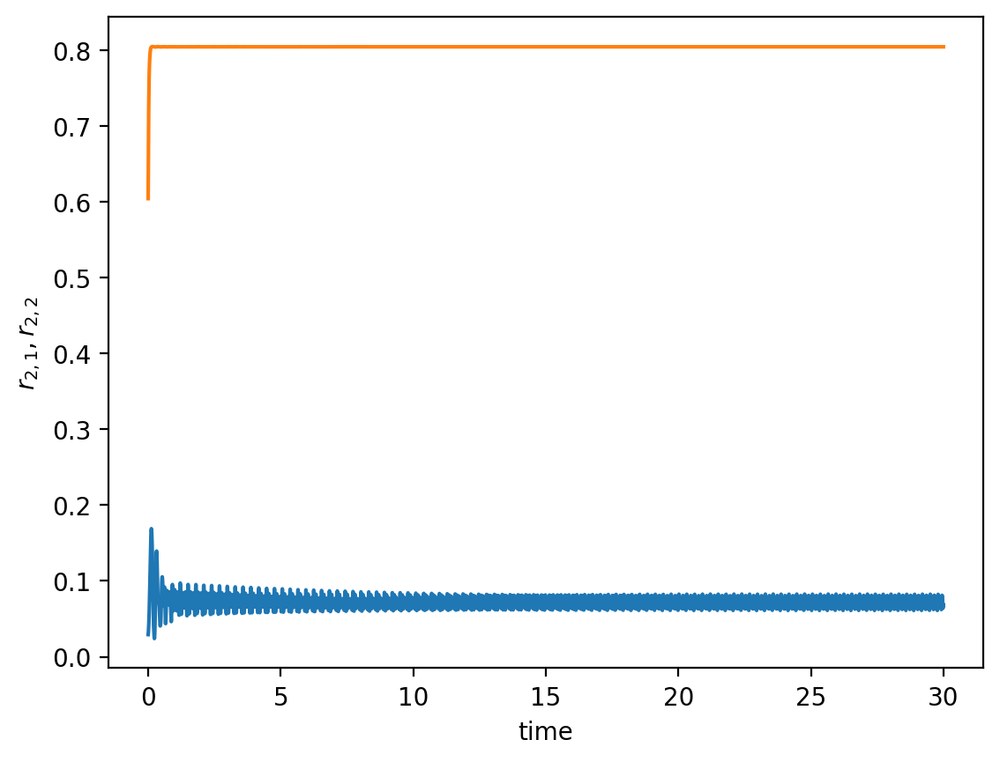

In [524]:
plt.plot(t,r1_1)
plt.plot(t,r1_2)
plt.xlabel('time')
plt.ylabel('$r_{2,1},r_{2,2}$')


Text(0, 0.5, '$r_{2,1},r_{2,2}$')

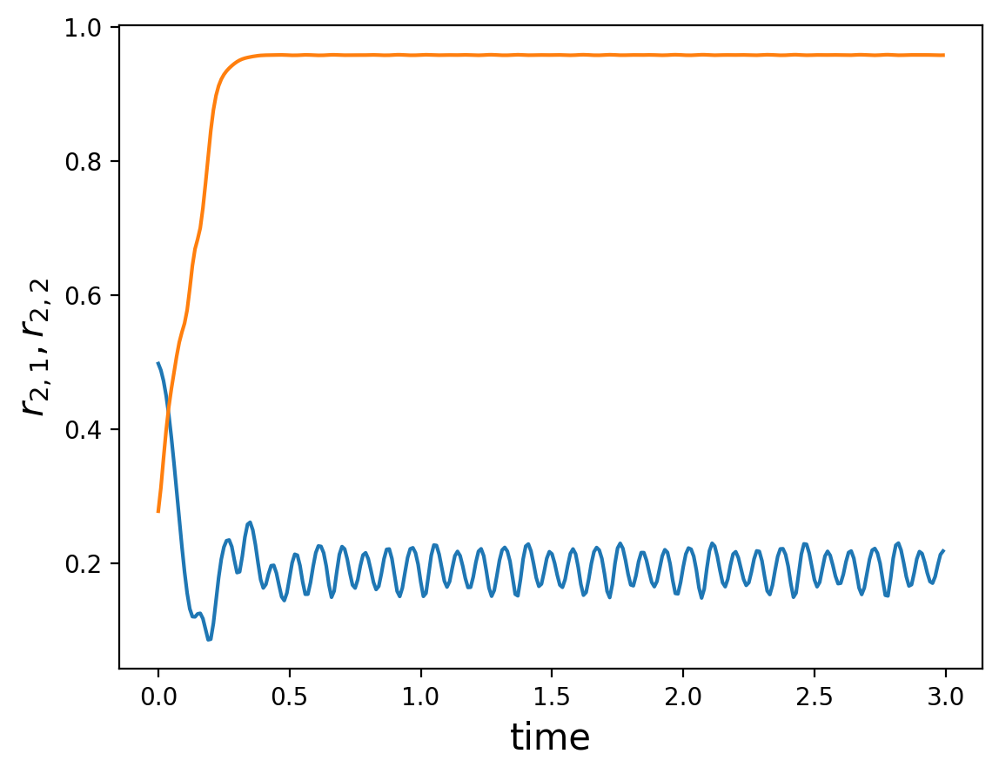

In [582]:
plt.plot(t,r2_1)
plt.plot(t,r2_2)
plt.xlabel('time',fontsize=15)
plt.ylabel('$r_{2,1},r_{2,2}$',fontsize=15)


In [1304]:
sol.shape

(3000, 50)

In [539]:
SS

100

([<matplotlib.axis.XTick at 0x28b04a550>,
 [Text(0, 0, '0'),
  Text(10, 0, 'Group1'),
  Text(20, 0, '20'),
  Text(30, 0, 'Group2'),
  Text(40, 0, '40')])

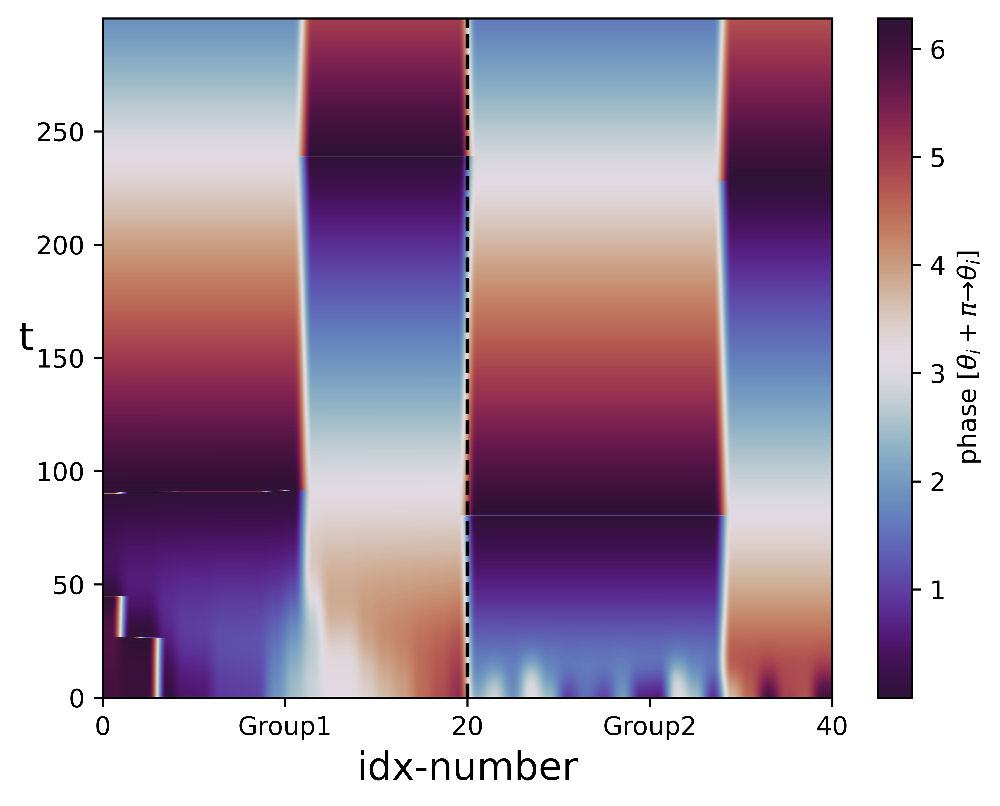

In [523]:
G1 =  np.argsort(sol[-1][:SS]%(2*np.pi))
G2 =  np.argsort(sol[-1][SS:]%(2*np.pi))
SG12 = np.array([*G1,*(SS+G2)])
# plt.imshow((sol[-300:,:])%np.pi,origin='lower',cmap='twilight_shifted',aspect='auto')
plt.figure(dpi=400)
# plt.imshow(sol[-300:,SG12]%np.pi,origin='lower',cmap='twilight_shifted',aspect='auto',extent=[0,2*N,t[-300],t[-1]])
plt.imshow(sol[0:-1,SG12]%(2*np.pi),origin='lower',cmap='twilight_shifted',aspect='auto',extent=[0,2*N,t[0],t[-1]])
cbar = plt.colorbar()
cbar.set_label(r'phase [$\theta_i+\pi\to\theta_i$]')

plt.axvline(SS,color='black',ls='--')
plt.ylabel('t',rotation=0,fontsize=15)
plt.xlabel('idx-number',fontsize=15)
plt.xticks([0,N//2,N,N+(N//2),2*N],[0,'Group1',N,'Group2',2*N])


# plt.imshow(sol[:]%np.pi,origin='lower',cmap ='hsv')


In [1307]:
np.sort(SG12)

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49])

(array([ 4.,  8.,  6.,  2., 10.,  5.,  3.,  5.,  7.]),
 array([0.        , 0.34906585, 0.6981317 , 1.04719755, 1.3962634 ,
        1.74532925, 2.0943951 , 2.44346095, 2.7925268 , 3.14159265]),
 <BarContainer object of 9 artists>)

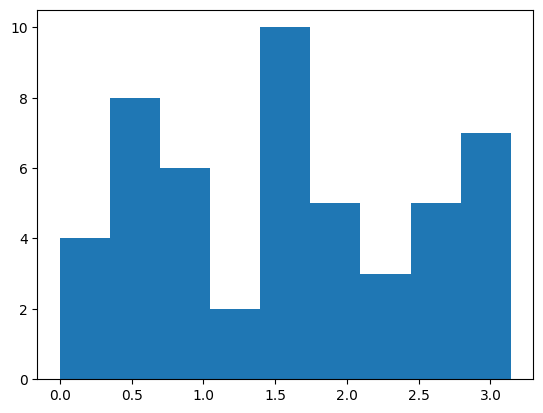

In [1342]:
bins = np.linspace(0,np.pi,10)
plt.hist(sol[-1][:SS]%(np.pi),bins=bins)
# plt.hist(sol[-1][N:]%(np.pi),bins=bins)

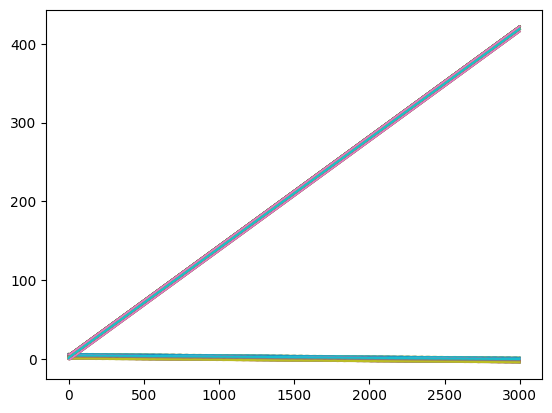

In [1345]:
plt.plot((sol.T-t).T)

Text(0, 0.5, ' oscillator')

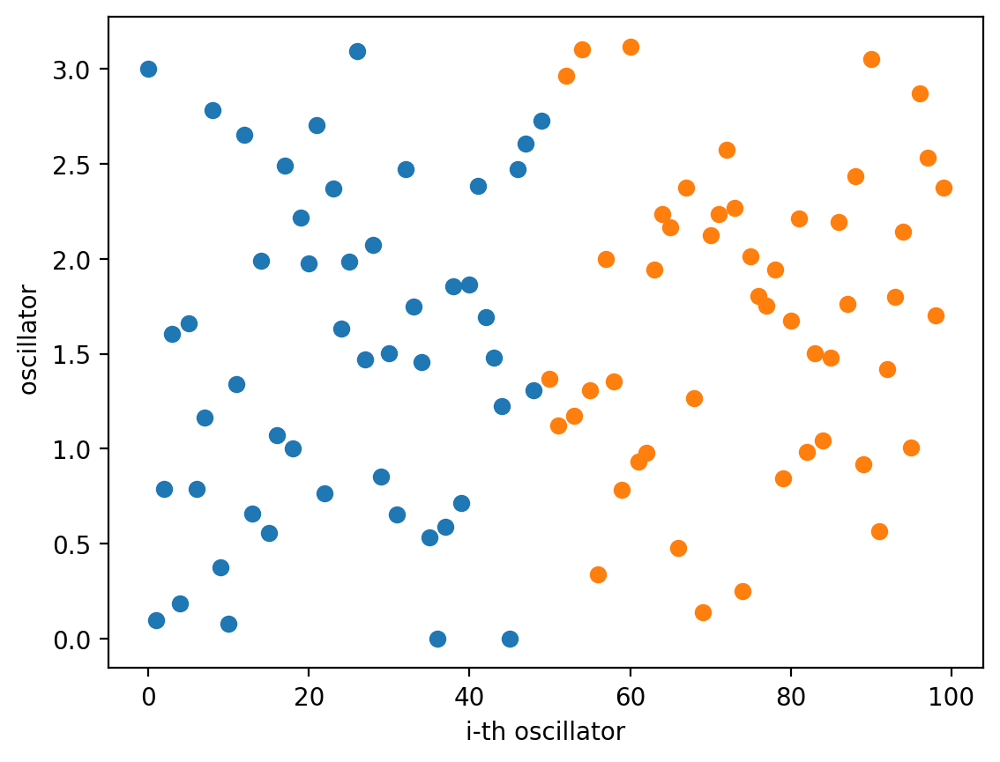

In [358]:
# plt.scatter(np.arange(N),np.sort(sol[-1][:N]%(np.pi)))
# plt.scatter(np.arange(N)+N,np.sort(sol[-1][N:]%(np.pi)))


plt.scatter(np.arange(SS),sol[0][:SS]%(np.pi))
plt.scatter(np.arange(2*N-SS)+SS,sol[0][SS:]%(np.pi))



# plt.scatter(np.arange(SS),sol[-20][:SS]%(np.pi))
# plt.scatter(np.arange(2*N-SS)+SS,sol[-20][SS:]%(np.pi))

# plt.plot(sol[-1]%(2*np.pi),'.')
plt.xlabel('i-th oscillator')
plt.ylabel(' oscillator')

G1 = np.arange(N)
G2 = np.arange(N,N*2)
G111 = (G1,G1,G1)
G121 = (G1,G2,G1)
G112 = (G1,G1,G2)
G122 = (G1,G2,G2)
G222 = (G2,G2,G2)
G221 = (G2,G2,G1)
G212 = (G2,G1,G2)
G211 = (G2,G1,G1)




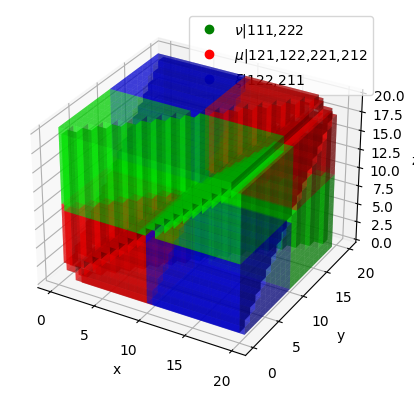

In [642]:
from numba import jit
import numpy as np
import matplotlib.pyplot as plt
# @jit(nopython=True)
def make_Bijk(N):
    Bijk = np.ones((N,N,N)) - np.eye(N)
    for i in range(N): Bijk[i,i,:]=0;Bijk[i,:,i]=0
    return Bijk
N = 10
Nt = N *2

Aij = np.ones((Nt,Nt)) - np.eye(Nt)
nu = 0.7 # inter group interaction
mu = 1 - nu # group-by group interaction
Bijk = make_Bijk(Nt) * mu
B0 = np.where(Bijk==0)
Bijk[:N,:N,:N] = nu
Bijk[N:,N:,N:] = nu
Bijk[B0] = 0

Nu0 = np.where(Bijk == nu)
Mu0 = np.where(Bijk == mu)


Bijk_box = np.zeros_like(Bijk,dtype=bool)
Bijk_box[np.where(Bijk!=0)] = 1
alpha = 0.5
colors = np .empty(list(Bijk_box.shape) + [4], dtype=np.float32)
# colors[Nu0] = [1, 0, 0, alpha]  # red
# colors[Mu0] = [0, 1, 0, alpha]  # red
colors[:N,:N,:N] = [1,0,0,alpha]
colors[N:,N:,N:] = [1,0,0,alpha]

colors[:N,:N,N:] = [0,1,0,alpha]
colors[:N,N:,:N] = [0,1,0,alpha]
colors[N:,N:,:N] = [0,1,0,alpha]
colors[N:,:N,N:] = [0,1,0,alpha]

colors[:N,N:,N:] = [0,0,1,alpha]
colors[N:,:N,:N] = [0,0,1,alpha]
# colors[*B0] = [0,0,1,alpha]


fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
 
# Voxels is used to customizations of the
# sizes, positions and colors.
ax.voxels(Bijk_box, facecolors=colors)
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')

ax.plot(np.nan,np.nan,np.nan,'o',label= r'$\nu$|111,222',color='green')
ax.plot(np.nan,np.nan,np.nan,'o',label= r'$\mu$|121,122,221,212',color='red')
ax.plot(np.nan,np.nan,np.nan,'o',label= r'$\xi$|122,211',color='blue')
ax.legend()

In [573]:
NUUU = [:N,:N,:N]

SyntaxError: invalid syntax (1177294304.py, line 1)

In [571]:
G112

AttributeError: 'tuple' object has no attribute 'shape'

In [559]:
colors[*G122]

array([[0. , 0. , 1. , 0.5],
       [0. , 0. , 1. , 0.5],
       [0. , 0. , 1. , 0.5],
       [0. , 0. , 1. , 0.5],
       [0. , 0. , 1. , 0.5],
       [0. , 0. , 1. , 0.5],
       [0. , 0. , 1. , 0.5],
       [0. , 0. , 1. , 0.5],
       [0. , 0. , 1. , 0.5],
       [0. , 0. , 1. , 0.5]], dtype=float32)

In [14]:
import numpy as np
A = 0.6*np.exp(1j)

In [15]:
abs(A)

0.6

In [16]:
abs(A*A)

0.35999999999999993

In [41]:
a = 0.08
b = 0.6
tau = - ((b**4 + (2*a-1)*b**2+(a+a**2))/(a+b**2))

tau

0.19636363636363638